# Import

In [2]:
import json
import itertools

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import pandas as pd
import seaborn as sns

from matplotlib import rcParams
rcParams['figure.figsize'] = 8, 8

# Function declaration

In [3]:
def save_fig(fig, name):
    fig.savefig("./graphs/" + name + ".png", format="png")

In [4]:
def fix_status(df_line):
    if df_line.status != "UNKNOWN":
        return df_line.status

    if df_line.objectives != {}:
        return "SATISFIABLE"

    return df_line.status

In [5]:
def get_optimal_solution(df_line):
    if df_line.status != "OPTIMAL_SOLUTION":
        return None

    return min(df_line.objectives.values())

In [6]:
def over_300(row):
    if row.solve_time > 300:
        row.solve_time = 300
        row.objectives = {k : v for k, v in row.objectives.items() if float(k) < 300}
        row.status = "Satisfiable" if len(row.objectives) > 1 else "Unknown"

    return row

In [7]:
def check(x : pd.DataFrame):
    try:
        model1 = x.iloc[0]
        model2 = x.iloc[1]

        status1 = model1.status
        status2 = model2.status

        obj1 = min(model1.objectives.values(), default=None)
        obj2 = min(model2.objectives.values(), default=None)
    except:
        return pd.DataFrame(x).assign(reason="NO CONFRONTATION")

    if status1 == "Optimal solution":
        if status2 == "Optimal solution":
            if obj1 != obj2:
                return x.assign(reason="BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT")
        elif status2 == "Unsatisfiable":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")
    elif status1 == "Unsatisfiable":
        if status2 == "Satisfiable" or status2 == "Optimal solution":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")
    elif status1 == "Satisfiable":
        if status2 == "Unsatisfiable":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")

In [8]:
def score(t1, t2):
    if t1 == 0 and t2 == 0:
        return (0.5, 0.5)
    else:
        return (
            t2 / (t1 + t2),
            t1 / (t1 + t2),
        )

def solved(x):
    if (
        x.status == "Optimal solution"
        or
        x.status == "Unsatisfiable"
        or
        x.status == "Satisfiable"
    ):
        return True

    return False

def optimal(x):
    return True if x.status == "Optimal solution" else False

def quality(x):
    return min(x.objectives.values(), default=None)

def better(x0, x1):
    q0 = quality(x0)
    q1 = quality(x1)
    if (
        (solved(x0) and not solved(x1))
        or
        (optimal(x0) and not optimal(x1))
        or
        ((q0 < q1) if q0 is not None and q1 is not None else False)
    ):
        return True

    return False

def borda_count(x):
    x0 = x.iloc[0]
    x1 = x.iloc[1]

    b0 = better(x0, x1)
    b1 = better(x1, x0)

    if b0 and not b1:
        return (1, 0)
    elif (b0 and b1) or (not b0 and not b1):
        return score(int(x0.solve_time), int(x1.solve_time))
    else:
        return (0, 1)


In [9]:
def import_df(path) -> pd.DataFrame:
    with open(path, "r") as f:
        results = json.load(f)

    dfs = []
    for k, v in results.items():
        x = pd.DataFrame(v).assign(**{
            "solver" : k
        })

        # Add test features
        test_feature = pd.DataFrame(
            x.problem.apply(lambda s : s.split("/")[-1][:-4].split("_")).tolist(),
            columns=["components", "flavours", "nodes", "resources", "comps_topology", "infra_topology", "test"]
        ).assign(**{
            "components" : lambda df : df.components.apply(lambda x : int(x[1:])),
            "flavours": 1, # lambda df : df.flavours.apply(lambda x : int(x[1:])),
            "nodes" : lambda df : df.nodes.apply(lambda x : int(x[1:])),
            "resources" : 1, # lambda df : df.resources.apply(lambda x : int(x[1:])),
            "comps_topology" : lambda df : df.comps_topology.apply(lambda x : x[1:].upper()),
            "infra_topology" : lambda df : df.infra_topology.apply(lambda x : x[1:].upper()),
            "test" : lambda df : df.test.apply(lambda x : int(x))
        }).assign(**{
            "model": x.problem.apply(lambda s : s.split("/")[-2].upper()).tolist(),
        })

        dfs.append(
            pd.merge(
                left=x,
                right=test_feature,
                right_index=True,
                left_index=True,
            )
        )

    return (
        pd.concat(dfs)
        .rename(columns={"model_y" : "model"})
        .assign(**{
            # Corrections for unkown status codes
            "solve_time" : lambda df : df.apply(
                lambda x :
                    300
                    if "UNKNOWN" in x["status"]
                    else x.solve_time,
                axis=1),
            "status" : lambda df : df.apply(
                lambda x : fix_status(x),
            axis=1),
        })
        .replace({ # Rename some stuff
            "cpsatlp": "OR-Tools",
            "gecode": "Gecode",
            "highs": "Highs",
            "chuffed": "Chuffed",
            "BARABASI": "small-world",
            "ERDOS": "random",
            "LADDER": "ladder",
            "WHEEL": "wheel",
            "PATH": "pipeline",
            "COMPLETE": "complete",
            "SATISFIABLE": "Satisfiable",
            "OPTIMAL_SOLUTION": "Optimal solution",
            "UNSATISFIABLE": "Unsatisfiable",
            "UNKNOWN": "Unknown",
            "ZEPHYRUS": "Zephyrus",
            "ERROR": "Error"
        })
        .assign(optimal_solution=lambda df : df.apply(
            lambda x : min(x.objectives.values()) if "Optimal solution" in x.status else None, axis=1
        ))
        .drop(columns=["problem"])
        .apply(over_300, axis=1)
        .reset_index(drop=True)
    )

In [10]:
def get_to_rerun_df(df, combinations):
    # Get instances were status is discordant or it is not run by all solvers
    indexes = set(df.set_index(["components", "nodes", "comps_topology", "test", "model", "solver"]).index)

    to_rerun = pd.DataFrame(
        data=combinations - indexes,
        columns=["components", "nodes", "comps_topology", "test", "model", "solver"]
    )
    to_rerun.drop_duplicates()

    check = (
        df
        .reset_index()
        .rename(columns={"index": "drop_index"})
        .drop(columns=["flavours", "resources", "flat_time", "solve_time", "infra_topology", "objectives"])
        .groupby(["components", "nodes", "comps_topology", "test"])
    )

    status_discordant = []
    not_all_solvers = []
    for _, group in check:
        if len(group) != len(solvers) * len(models): # 6 = 3 solvers x 2 models
            not_all_solvers.append(group)
            continue

        a = group.status.value_counts().reset_index()
        if len(a.query("status == 'Unsatisfiable'")) > 0 and len(a.query("status != 'Unsatisfiable'")) > 0:
                status_discordant.append(group)

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(not_all_solvers).drop_duplicates() if len(not_all_solvers) > 0 else pd.DataFrame()
    ])

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(status_discordant).drop_duplicates() if len(status_discordant) > 0 else pd.DataFrame()
    ])

    return to_rerun.drop(columns=["drop_index", "status", "optimal_solution"]).drop_duplicates()

# DataFrame import

In [11]:
component_topologies = ['small-world', 'random', 'pipeline']
solvers = ['Chuffed', 'Highs', 'OR-Tools', 'Gecode']
models = ['FREEDA', 'Zephyrus']

In [12]:
combinations = set(itertools.product(
    range(4, 32 + 1), #components
    range(3, 32 + 1), #nodes
    component_topologies,
    range(0, 3), #tests
    models,
    solvers
))
len(combinations)

62640

In [13]:
color = {
    "Chuffed" : "red",
    "OR-Tools": "orange",
    "Gecode" : "#1f77b4",
    "Highs" : "green"
}

marker = {
    "Chuffed" : ".",
    "OR-Tools": "+",
    "Gecode" : "x",
    "Highs" : "2"
}

marker_model = {
    "FREEDA": "*",
    "Zephyrus": "x"
}

color_model = {
    "FREEDA": "#1f77b4",
    "Zephyrus": "red"
}

In [14]:
df = import_df("results/new-model-results-32x32.json")

In [15]:
df.query("status == 'Error'")

,status,flat_time,solve_time,objectives,flatzinc_vars,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
8662,Error,8.294,99.761,{},42892,Gecode,20,1,4,1,random,complete,1,Zephyrus,NaN
8680,Error,8.666,113.838,{},43314,Gecode,20,1,5,1,random,complete,1,Zephyrus,NaN
8751,Error,7.896,107.632,{},45002,Gecode,20,1,9,1,random,complete,0,Zephyrus,NaN
8752,Error,8.675,120.872,{},49070,Gecode,20,1,9,1,random,complete,1,Zephyrus,NaN
8753,Error,8.901,112.614,{},45002,Gecode,20,1,9,1,random,complete,2,Zephyrus,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15646,Error,45.491,167.451,{},237334,Gecode,31,1,28,1,random,complete,1,Zephyrus,NaN
15647,Error,44.681,194.606,{},371546,Gecode,31,1,28,1,random,complete,2,Zephyrus,NaN
15657,Error,35.792,58.769,{},266962,Gecode,31,1,19,1,random,complete,0,Zephyrus,NaN
15658,Error,36.806,61.178,{},282961,Gecode,31,1,19,1,random,complete,1,Zephyrus,NaN


In [16]:
# Entirely missing
indexes = set(df.set_index(["components", "nodes", "comps_topology"]).index)
cmbs = set(itertools.product(
    range(4, 32 + 1), #components
    range(3, 32 + 1), #nodes
    component_topologies
))

to_rerun = pd.DataFrame(
    data=cmbs - indexes,
    columns=["components", "nodes", "comps_topology"]
).drop_duplicates()
to_rerun

,components,nodes,comps_topology


In [17]:
indexes = set(df.set_index(["components", "nodes", "comps_topology", "test", "model", "solver"]).index)
entirely_missing = (
    pd.DataFrame(
        data=combinations - indexes,
        columns=["components", "nodes", "comps_topology", "test", "model", "solver"]
    )
    .groupby(["components", "nodes", "comps_topology", "test"])
    .count()
    #.query("model == " + str(len(models) * len(solvers)))
    .reset_index()
    [["components", "nodes", "comps_topology"]]
    .drop_duplicates()
)
entirely_missing

,components,nodes,comps_topology


In [18]:
indexes = set(df.set_index(["components", "nodes", "comps_topology", "test", "model", "solver"]).index)
solver_failure = (
    pd.DataFrame(
        data=combinations - indexes,
        columns=["components", "nodes", "comps_topology", "test", "model", "solver"]
    )
    .groupby(["components", "nodes", "comps_topology", "test", "model"])
    .aggregate({"solver" : [set, "count"]})
    .reset_index()
)
solver_failure.columns = [''.join(col).strip() for col in solver_failure.columns.values]

print(solver_failure.model.unique())
#all(solver_failure.query("solvercount == 1").solverset.apply(lambda x : len(x) == 1 and 'Gecode' in x))
solver_failure

[]


,components,nodes,comps_topology,test,model,solverset,solvercount


In [19]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

errors = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        if len(group) <= 1:
            continue

        a = check(group)
        if a is not None:
            errors.append(a)

In [20]:
if len(errors) > 0:
    error_optimal_obj_discordant = (
        pd.concat(errors)
        .drop(columns=["objectives"])
        .drop_duplicates()
        .query("reason == 'BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT'")
        .groupby(["components", "nodes", "comps_topology", "test"])
    )

    for _, g in error_optimal_obj_discordant:
        optimals = g.groupby("model").aggregate({"optimal_solution": set})
        freeda_optimals = optimals.loc["FREEDA"]["optimal_solution"]
        zephyrus_optimals = optimals.loc["Zephyrus"]["optimal_solution"]

        if len(freeda_optimals) != 1:
            print("MORE SOLUTIONS IN FREEDA")

        if len(zephyrus_optimals) != 1:
            print("MORE SOLUTIONS IN ZEPHYRUS")

        if len(freeda_optimals) != len(zephyrus_optimals):
            print("SOME MODEL-SOLVER COMBINATION PRESENT MORE THAN A SOLUTION")
else:
    print("NO ERRORS")

NO ERRORS


In [21]:
df.solver.unique()

array(['Gecode', 'Highs', 'Chuffed', 'OR-Tools'], dtype=object)

In [22]:
len(combinations)

62640

In [23]:
len(combinations) - len(df.drop(columns=["objectives"]).drop_duplicates())

0

In [24]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

errors = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        a = check(group)
        if a is not None:
            errors.append(a)

In [25]:
pd.concat(errors) if len(errors) > 0 else print("NO ERRORS")

NO ERRORS


# Clean up

In [26]:
df.query("solve_time > 300")

,status,flat_time,solve_time,objectives,flatzinc_vars,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution


# DataFrame Analysis

In [27]:
df.status.unique()

array(['Optimal solution', 'Satisfiable', 'Unknown', 'Error'],
      dtype=object)

In [28]:
df.status.value_counts(normalize=True)

status
Optimal solution    0.895833
Unknown             0.071951
Error               0.028879
Satisfiable         0.003337
Name: proportion, dtype: float64

In [29]:
df[["components", "status"]].groupby("components").value_counts()

components  status          
4           Optimal solution    2160
5           Optimal solution    2160
6           Optimal solution    2157
            Satisfiable            3
7           Optimal solution    2119
                                ... 
31          Satisfiable            4
32          Optimal solution    1751
            Unknown              241
            Error                166
            Satisfiable            2
Name: count, Length: 87, dtype: int64

In [30]:
df[["nodes", "status"]].groupby("nodes").value_counts()

nodes  status          
3      Optimal solution    1867
       Unknown              152
       Error                 62
       Satisfiable            7
4      Optimal solution    1868
                           ... 
31     Satisfiable            5
32     Optimal solution    1872
       Unknown              156
       Error                 53
       Satisfiable            7
Name: count, Length: 120, dtype: int64

In [31]:
pd.concat(
    [
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(),
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(normalize=True) * 100
    ],
    axis=1,
    keys=['counts', '%']
).reset_index()#.to_csv("./status_aggregated.csv", index=False)

,components,nodes,status,counts,%
0,4,3,Optimal solution,72,100.000000
1,4,4,Optimal solution,72,100.000000
2,4,5,Optimal solution,72,100.000000
3,4,6,Optimal solution,72,100.000000
4,4,7,Optimal solution,72,100.000000
...,...,...,...,...,...
2079,32,31,Unknown,12,16.666667
2080,32,31,Error,6,8.333333
2081,32,32,Optimal solution,58,80.555556
2082,32,32,Unknown,9,12.500000


<Axes: title={'center': 'Distribution of solve_time'}>

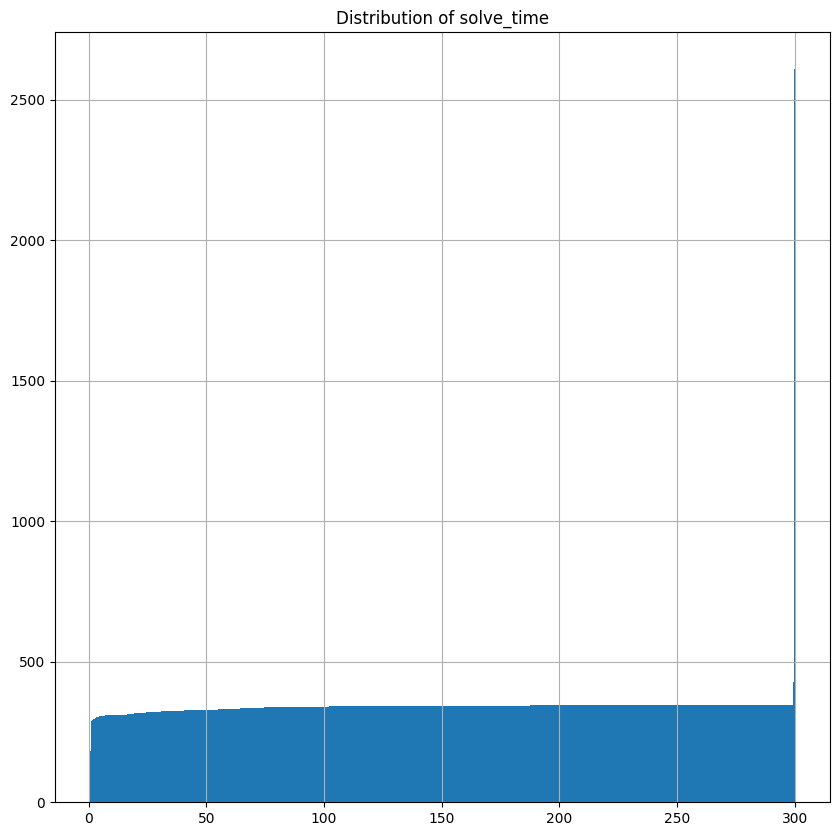

In [32]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of solve_time")
vbs = df.sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution only for Optimal solutions'}>

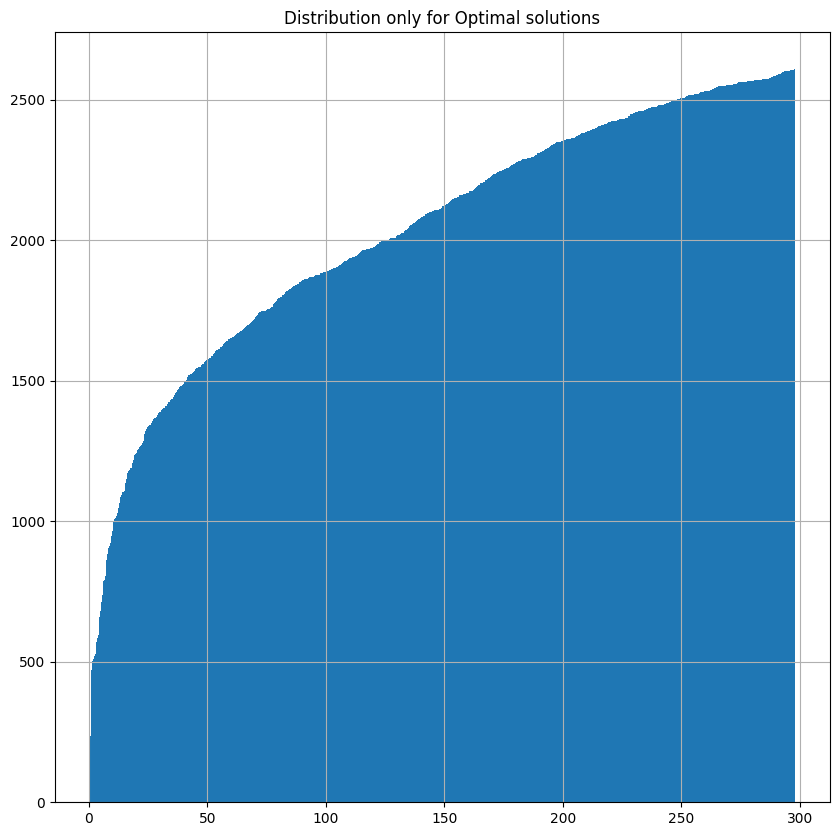

In [33]:
plt.figure(figsize=(10, 10))
plt.title("Distribution only for Optimal solutions")
vbs = df.query("status == 'Optimal solution'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

# Solve Time

### Components

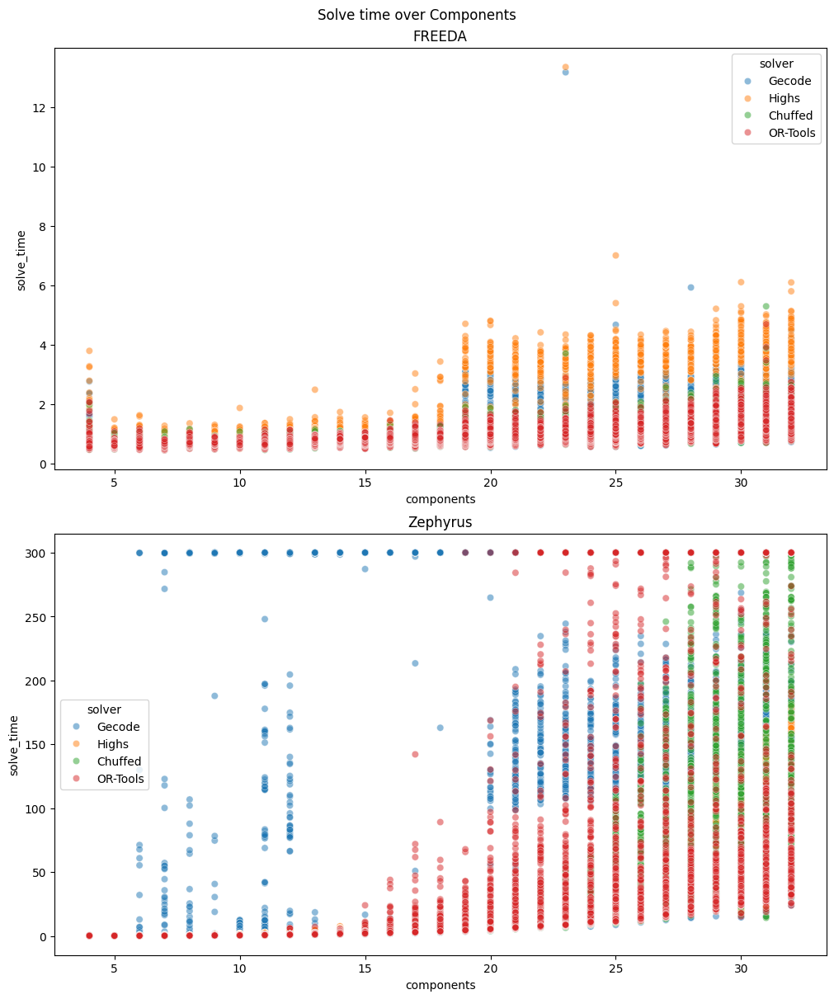

In [34]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

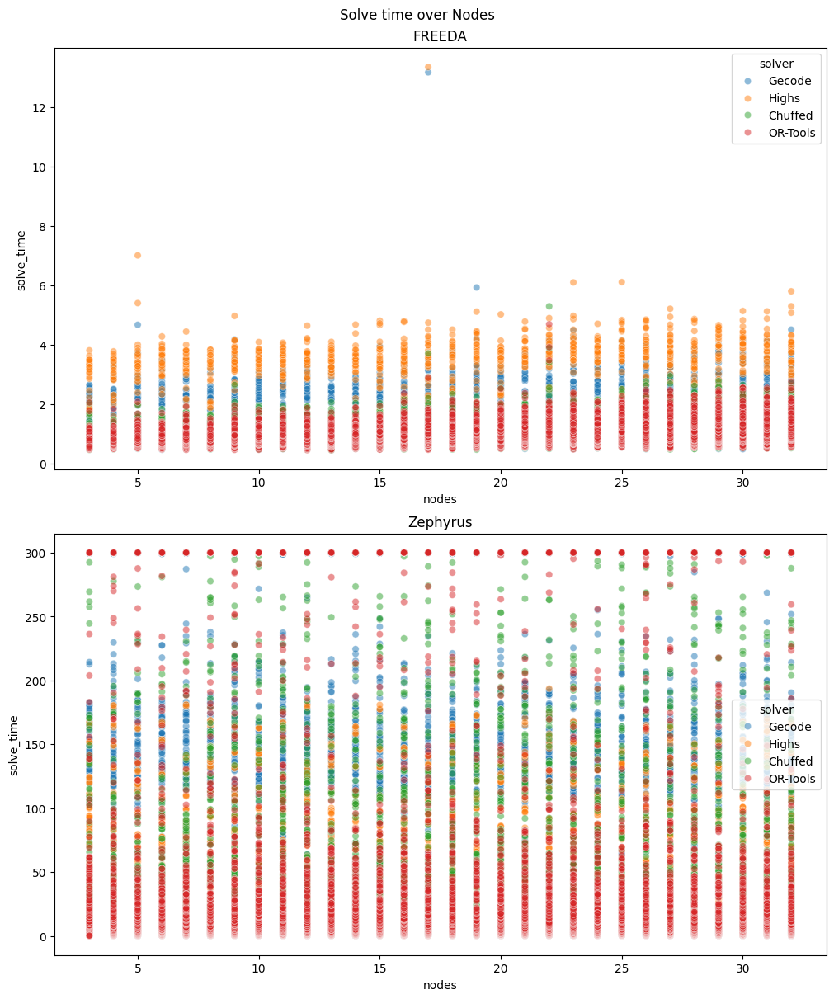

In [35]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

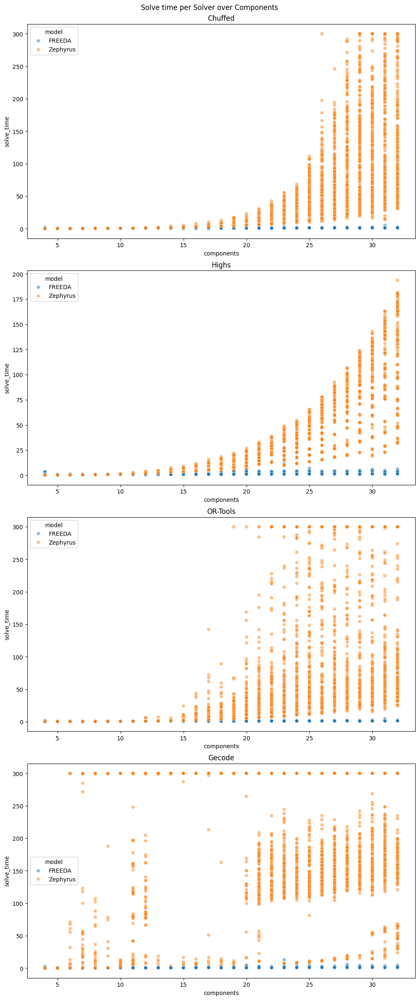

In [36]:
fig, axs = plt.subplots(len(solvers), 1, constrained_layout=True)
fig.suptitle("Solve time per Solver over Components")
fig.set_figheight(6 * len(solvers))
fig.set_figwidth(10)
for s, ax in zip(solvers, axs):
    ax.set_title(str(s))
    sns.scatterplot(
        data=df.query("solver == @s"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="model",
        ax=ax
    )

### Components x nodes

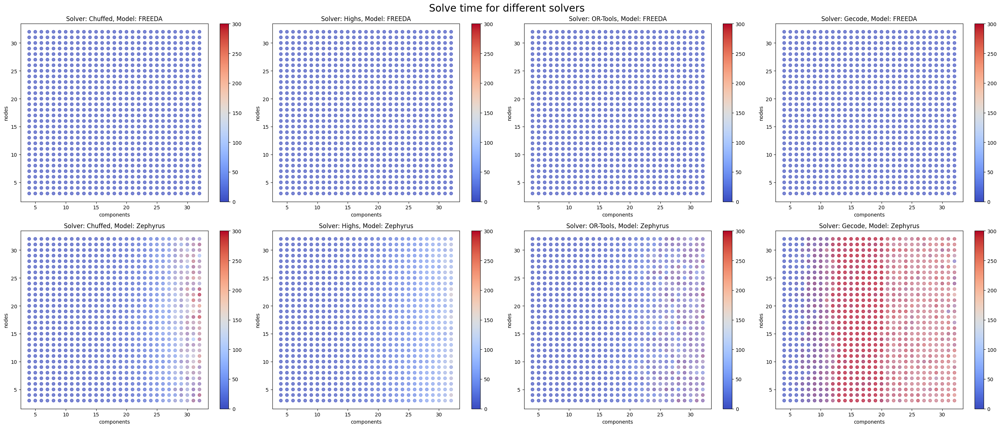

In [37]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)
        fig.colorbar(ScalarMappable(norm=norm, cmap="coolwarm"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

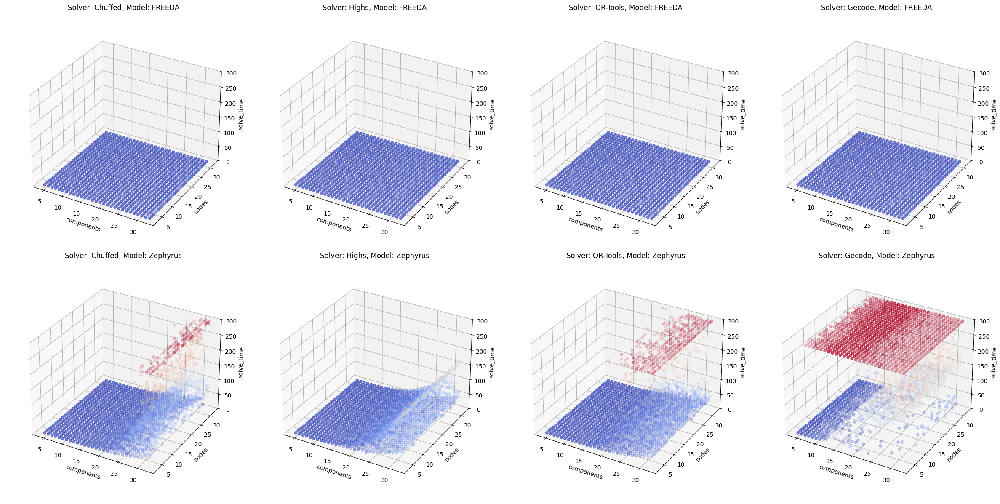

In [38]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_zlabel("solve_time")
        ax.set_title("Solver: " + s + ", Model: " + m)
        ax.set_box_aspect(None, zoom=0.90)
        ax.set_zlim([0, 300])

fig.tight_layout()

### Topologies

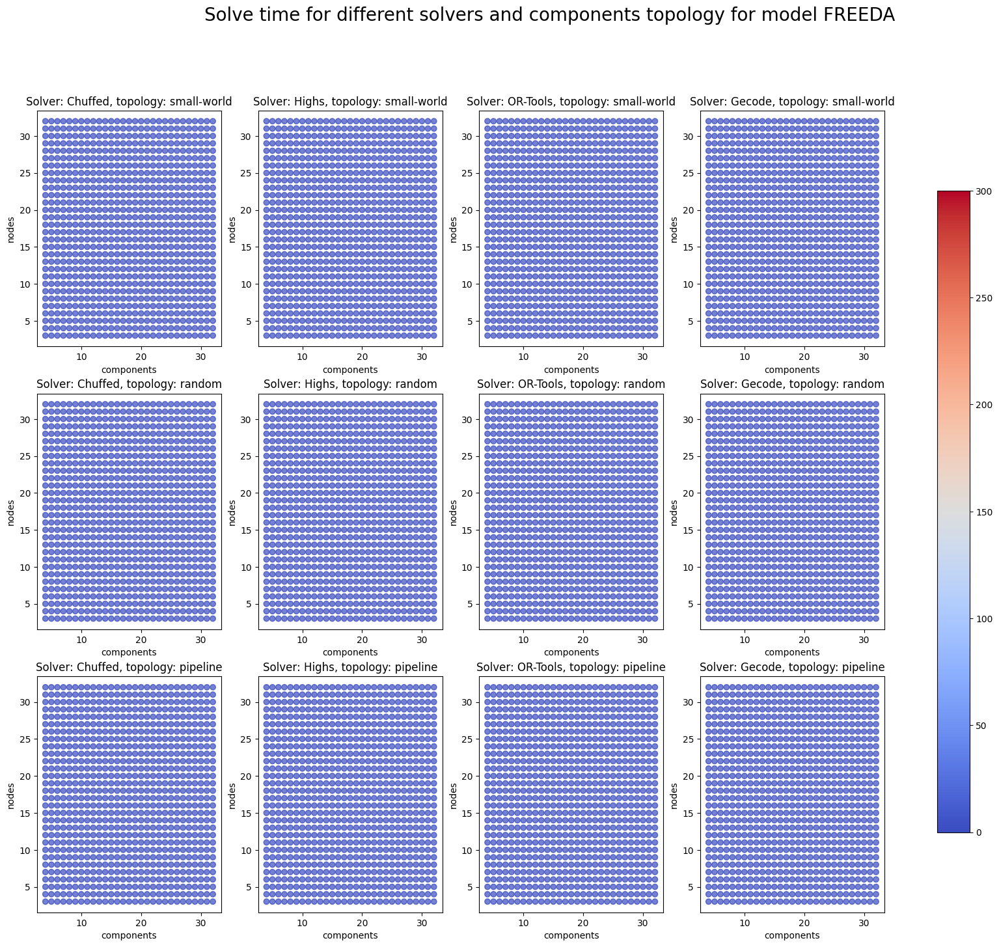

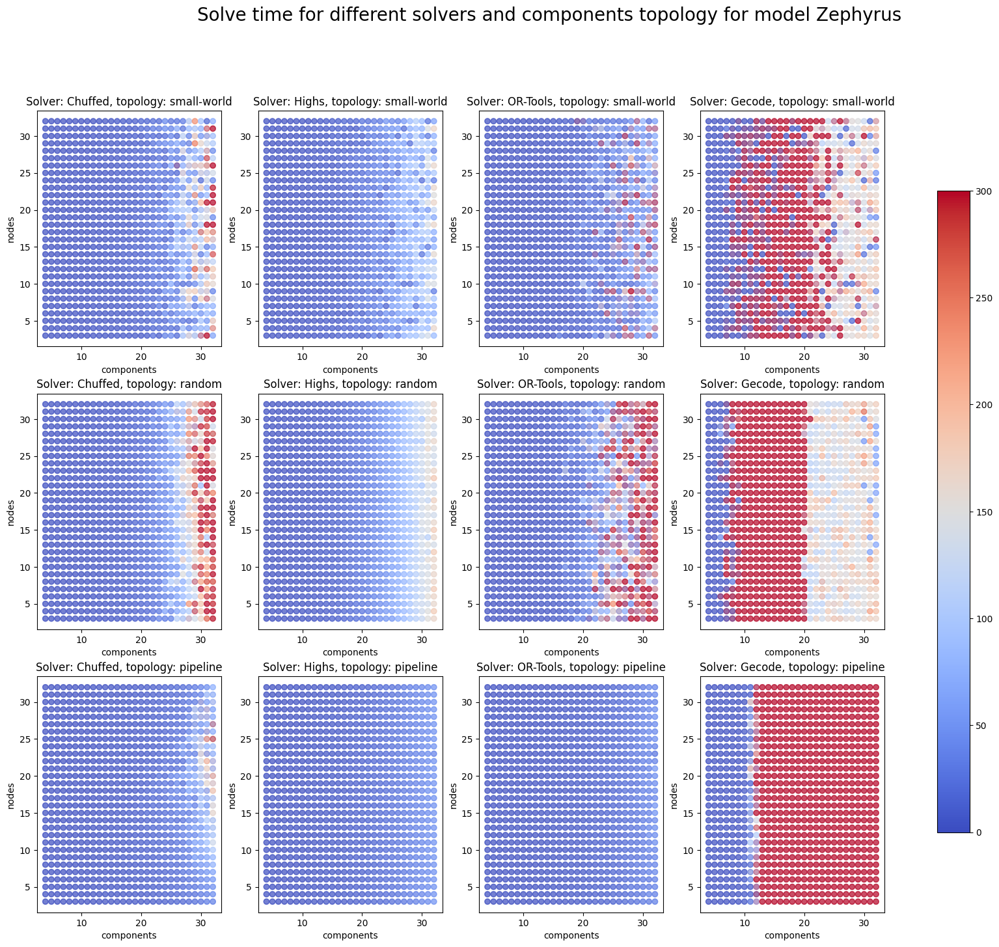

In [39]:
norm = Normalize(vmin=0, vmax=300)
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 4 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Solve time for different solvers and components topology for model " + m, fontsize=20)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

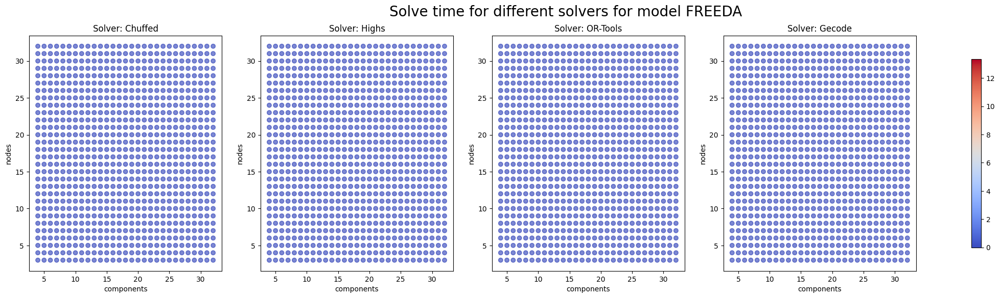

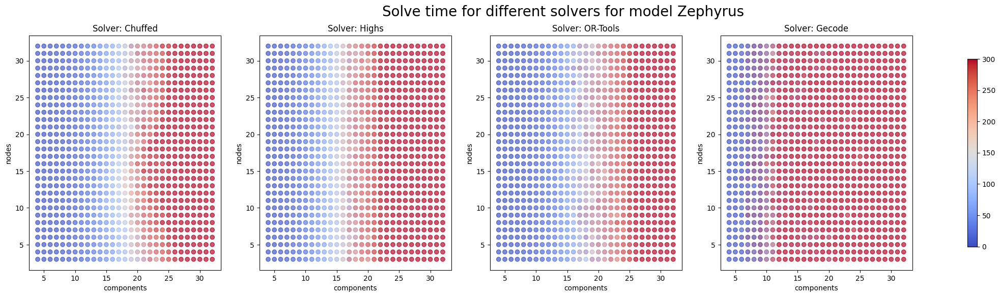

In [40]:
for m in models:
    fig, axs = plt.subplots(
        nrows=1,
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6)
    )
    axs_reshaped = axs.reshape(-1)
    df_model = df.query("model == @m")
    for solver, ax in zip(solvers, axs_reshaped):
        d = df_model.query("solver == @solver")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver)

    norm = Normalize(vmin=0, vmax=df_model.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time for different solvers for model " + m, fontsize=20)

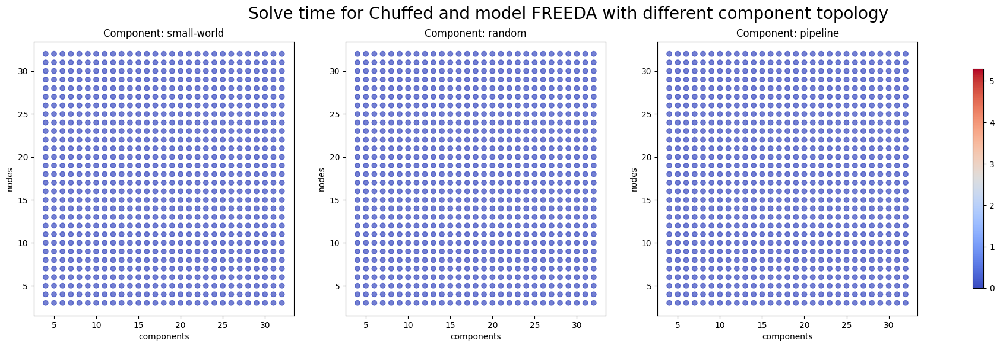

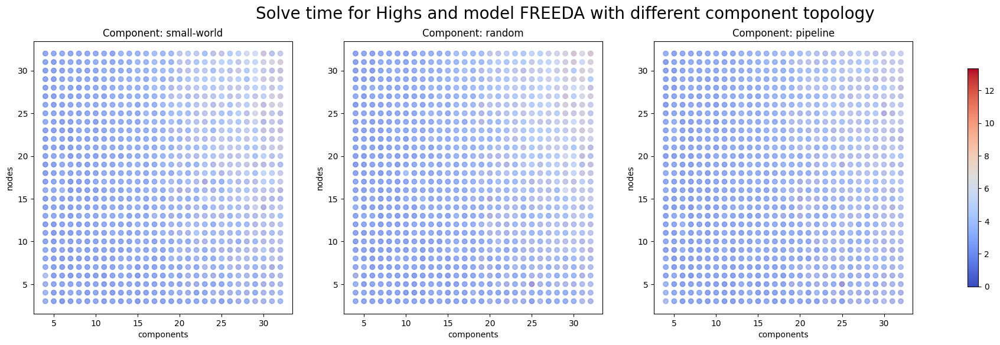

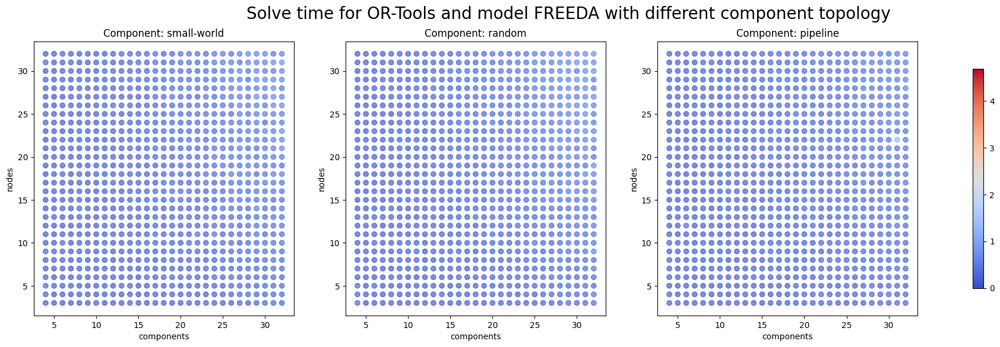

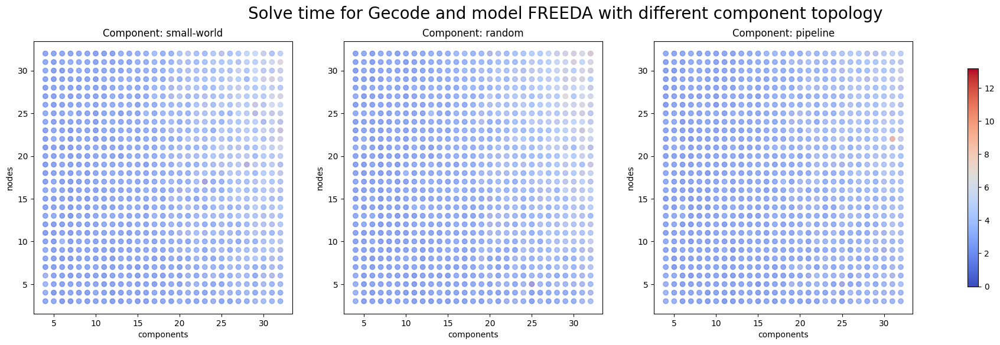

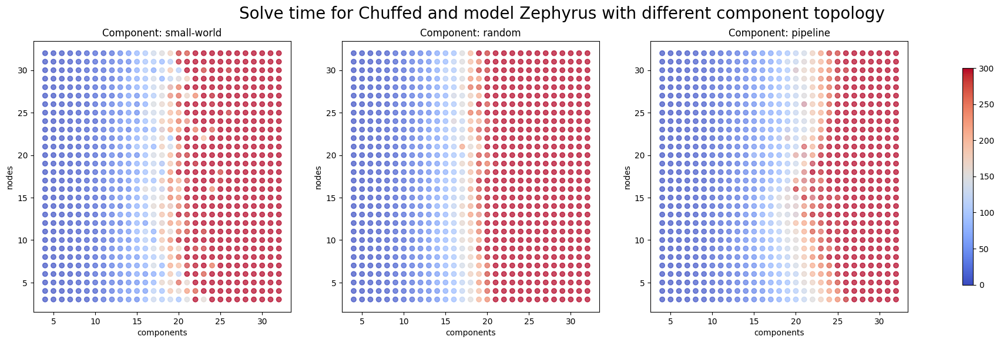

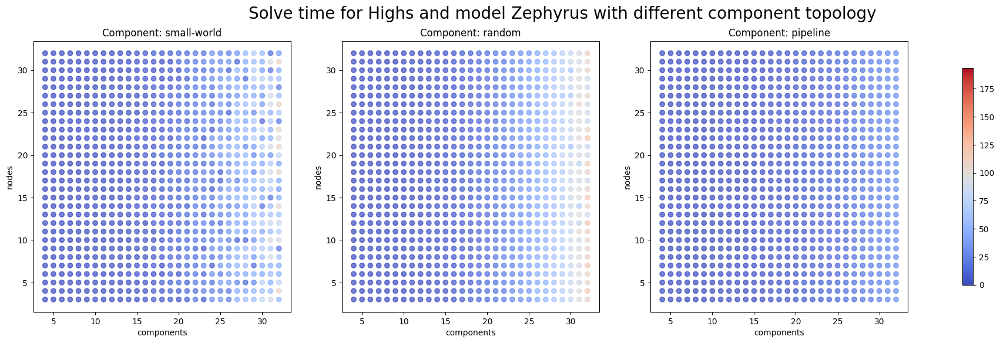

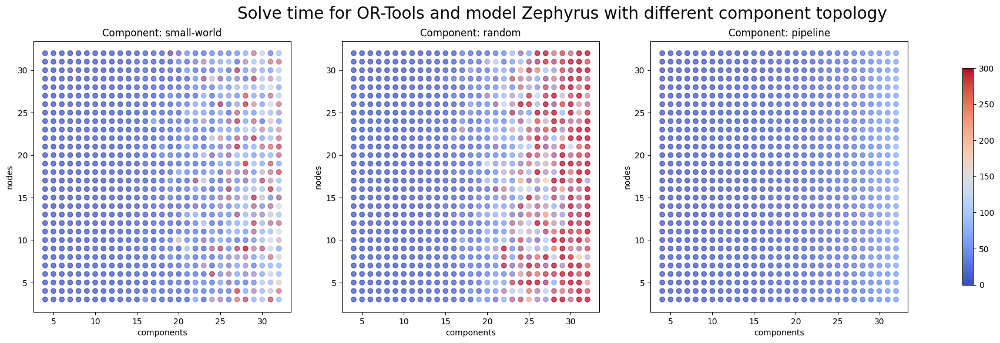

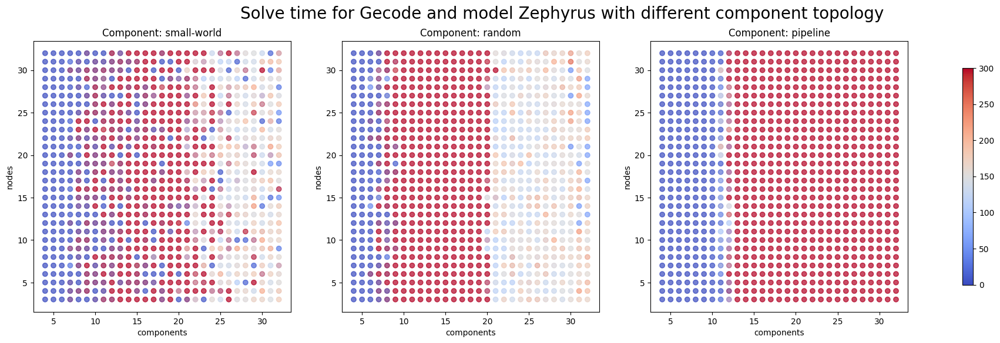

In [41]:
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=1,
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6)
        )
        axs_reshaped = axs.reshape(-1)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for comps_topology, ax in zip(component_topologies, axs_reshaped):
            d = df_solver_problem.query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.solve_time,
                cmap="coolwarm",
                norm=norm,
                alpha=1.0/3
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology)

        norm = Normalize(vmin=0, vmax=df_solver_problem.solve_time.max())
        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Solve time for " + solver + " and model " + m + " with different component topology", fontsize=20)


# Flat time

### Components

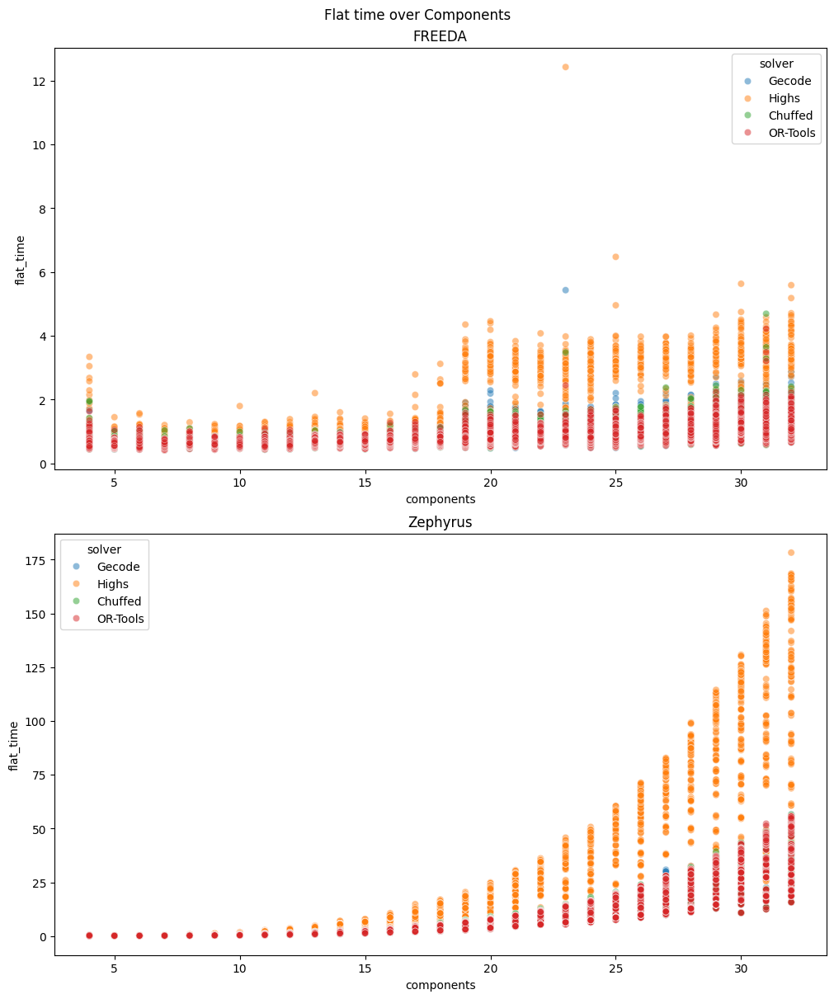

In [42]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

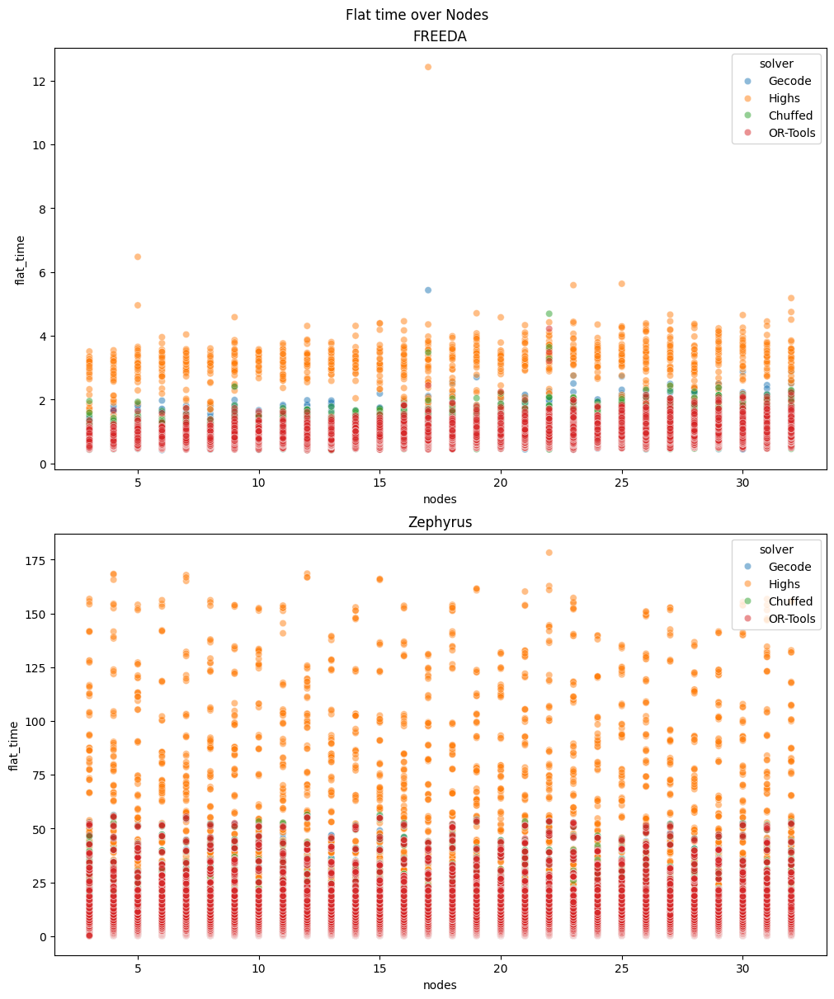

In [43]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Components x nodes

Text(0.5, 0.98, 'Flat time for different solvers')

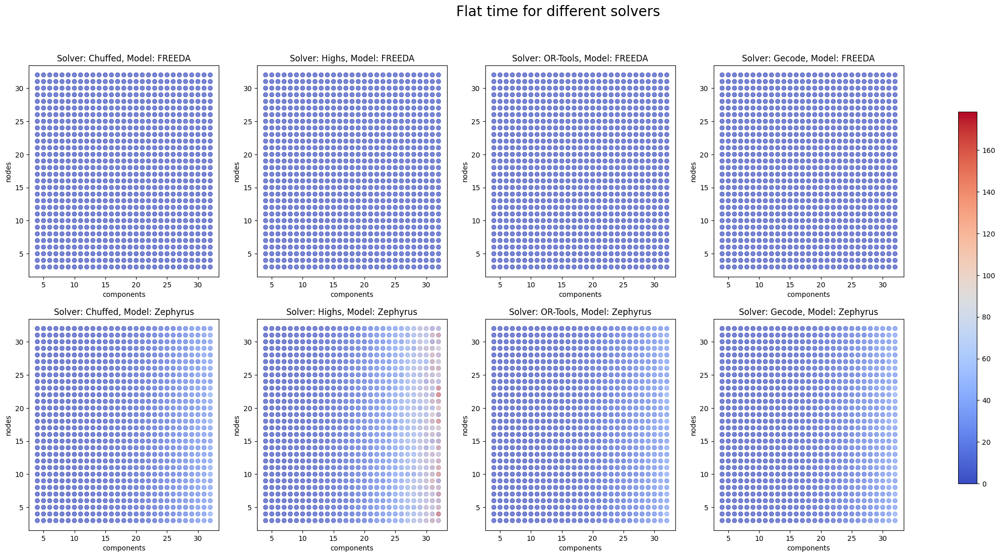

In [44]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)

fig.colorbar(
    ScalarMappable(norm=norm, cmap="coolwarm"),
    ax=axs.ravel().tolist(),
    orientation='vertical',
    shrink=0.8
)
fig.suptitle("Flat time for different solvers", fontsize=20)

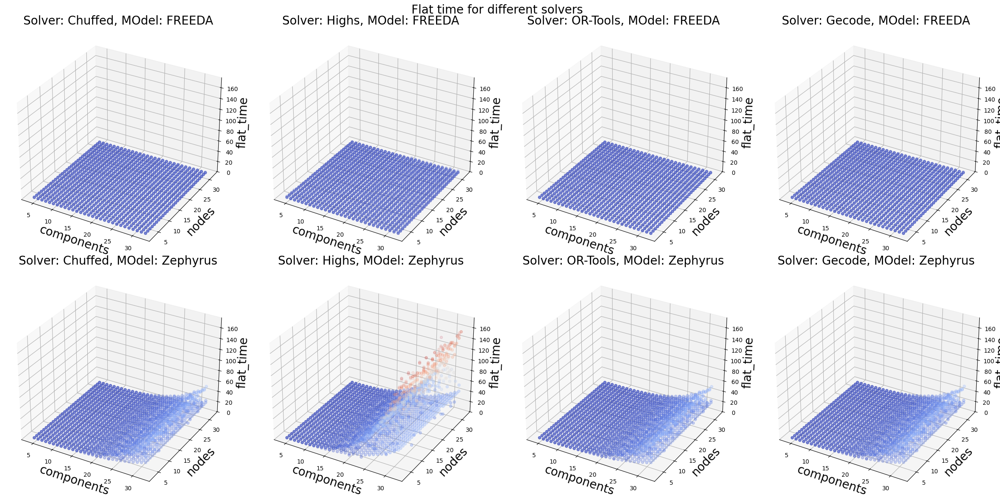

In [45]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.flat_time,
            c=d.flat_time,
            norm=norm,
            cmap="coolwarm",
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_zlim([0, df.flat_time.max()])
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("flat_time", fontsize=20)
        ax.set_title("Solver: " + s + ", MOdel: " + m, fontsize=20)

fig.suptitle("Flat time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

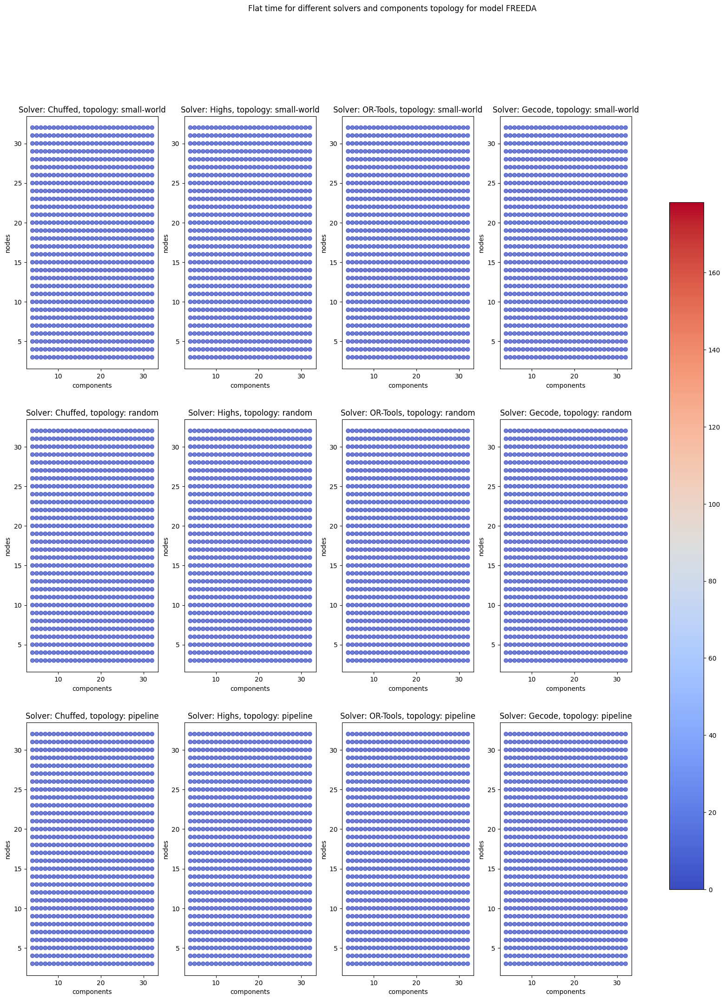

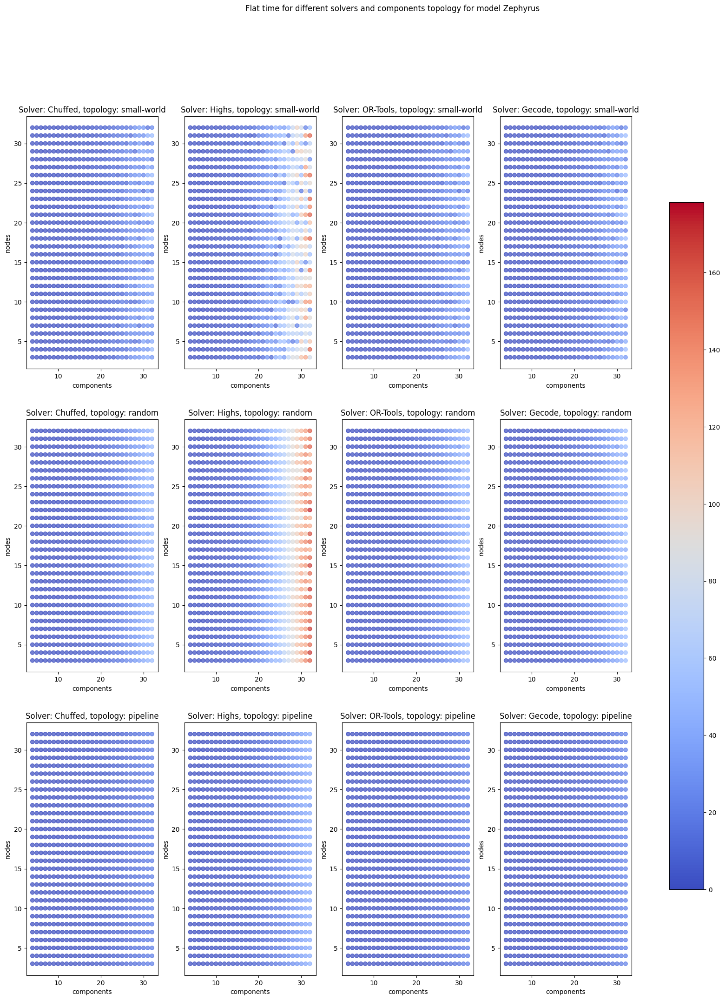

In [46]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Flat time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

# Flat time vs Solve time

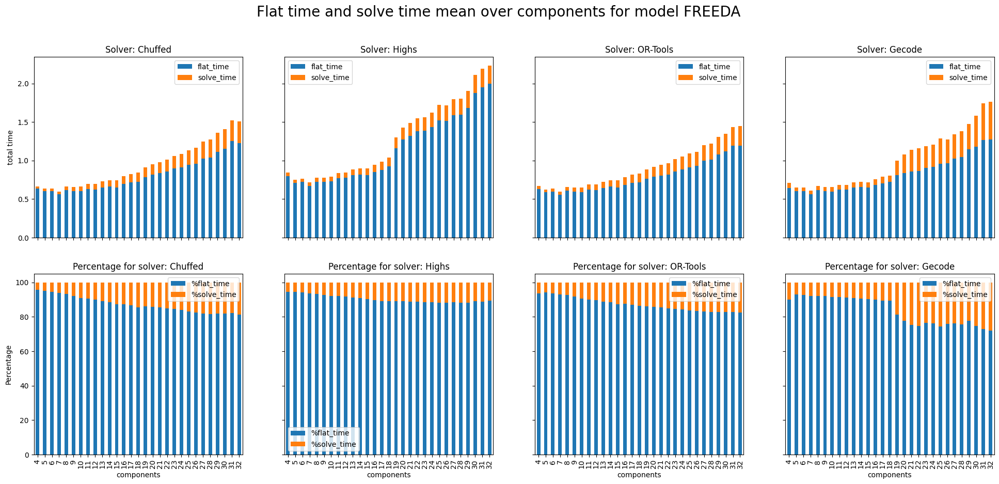

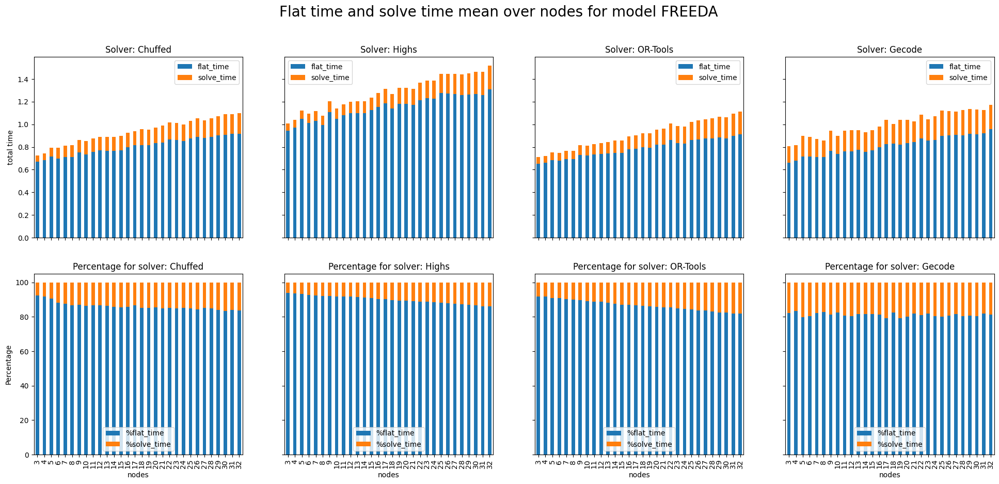

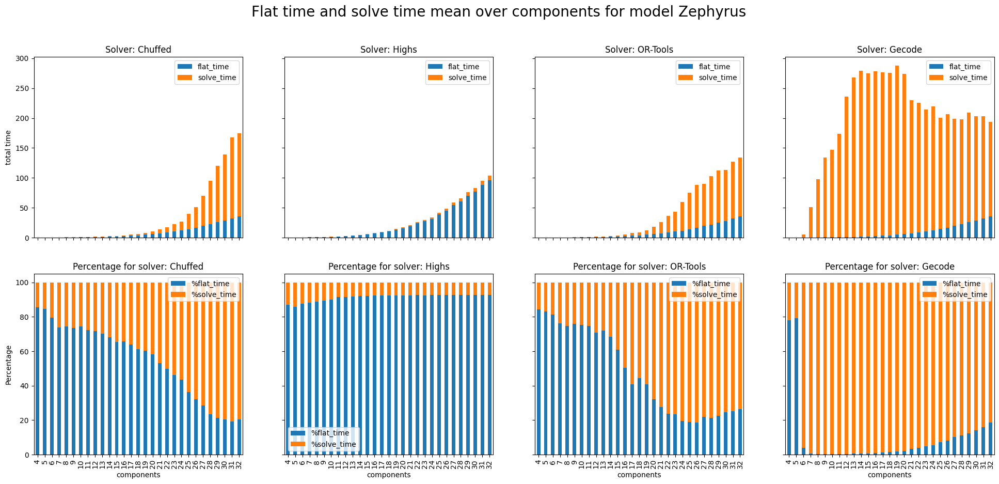

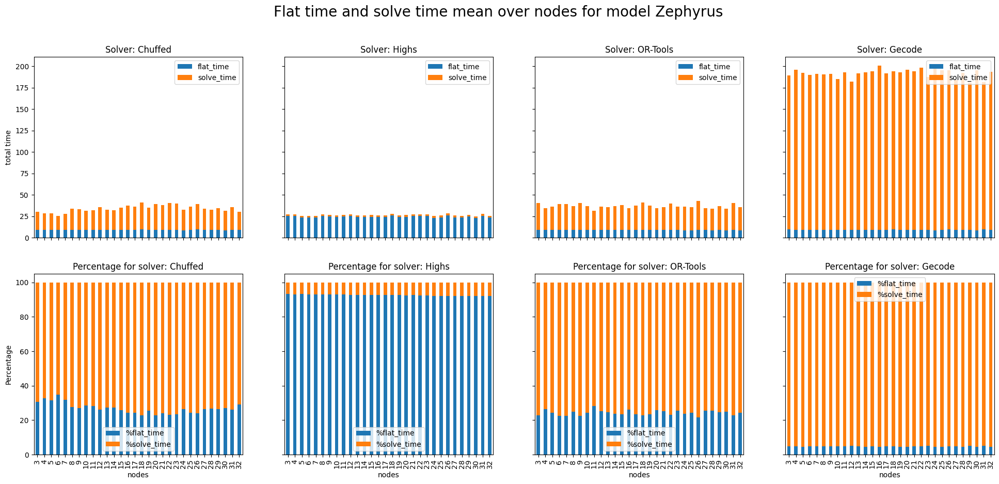

In [47]:
for m in models:
    for over in ["components", "nodes"]:
        fig, axs = plt.subplots(
            nrows=2,
            ncols=len(solvers),
            figsize=(6 * len(solvers), 10),
            sharex=True,
            sharey="row"
        )
        axs_reshaped = axs.reshape(-1)

        for solver, (i, ax) in zip(solvers, enumerate(axs_reshaped)):
            times = (
                df
                .query("solver == @solver")
                .query("model == @m")
                .assign(**{
                    "solve_time" : lambda df : df["solve_time"] - df["flat_time"]
                })
                .groupby(over)
                [["flat_time", "solve_time"]]
                .mean()
            )

            times.plot.bar(
                ax=ax,
                stacked=True,
                title="Solver: " + solver,
            )
            ax.set_ylabel("total time")

            times.assign(**{
                "%flat_time" : lambda df : (df["flat_time"] / (df["flat_time"] + df["solve_time"])) * 100,
                "%solve_time" : lambda df : (df["solve_time"] / (df["flat_time"] + df["solve_time"])) * 100
            }).drop(
                columns=["solve_time", "flat_time"]
            ).plot.bar(
                stacked=True,
                title="Percentage for solver: " + solver,
                ax=axs_reshaped[len(solvers) + i],
            )
            axs_reshaped[len(solvers) + i].set_ylabel("Percentage")

        fig.suptitle("Flat time and solve time mean over " + over + " for model " + m, fontsize=20)
        plt.show()


# Paper images and tables

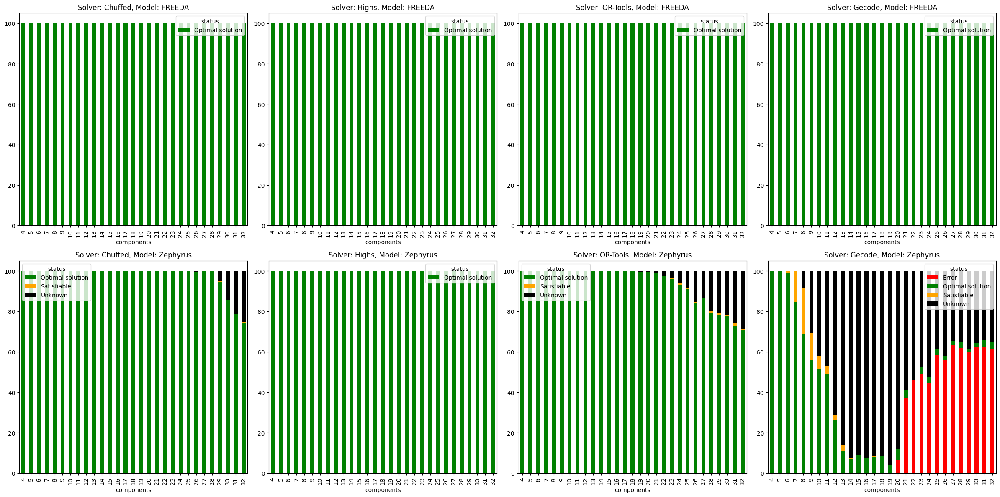

In [48]:
colors = {
    "Optimal solution": "green",
    "Unsatisfiable": "#1f77b4",
    "Unknown": "black",
    "Satisfiable" : "orange",
    "Error" : "red"
}

patterns = {
    "Optimal solution": "*",
    "Unsatisfiable": ".",
    "Unknown": "O",
    "Error": "+",
    "Satisfiable" : "/"
}

fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 12)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color=colors,
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

fig.tight_layout()
plt.show()

Text(0, 0.5, 'solve time difference')

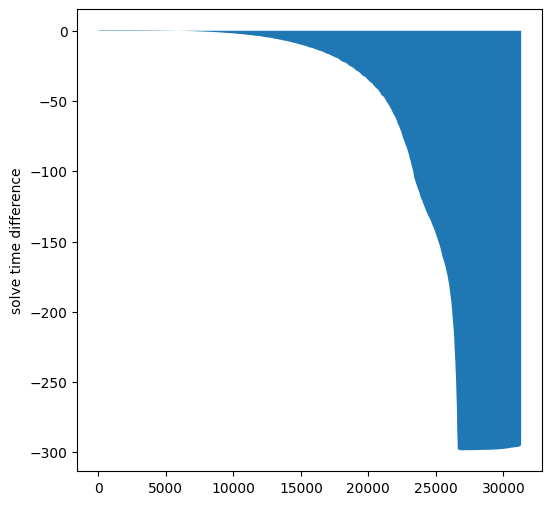

In [49]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

area_plot = (
    df.query("model == 'FREEDA'").solve_time.sort_values().reset_index(drop=True)
    -
    df.query("model == 'Zephyrus'").solve_time.sort_values().reset_index(drop=True)
).reset_index()

ax.fill_between(area_plot.index, area_plot.solve_time)
ax.set_xlabel("")
ax.set_ylabel("solve time difference")

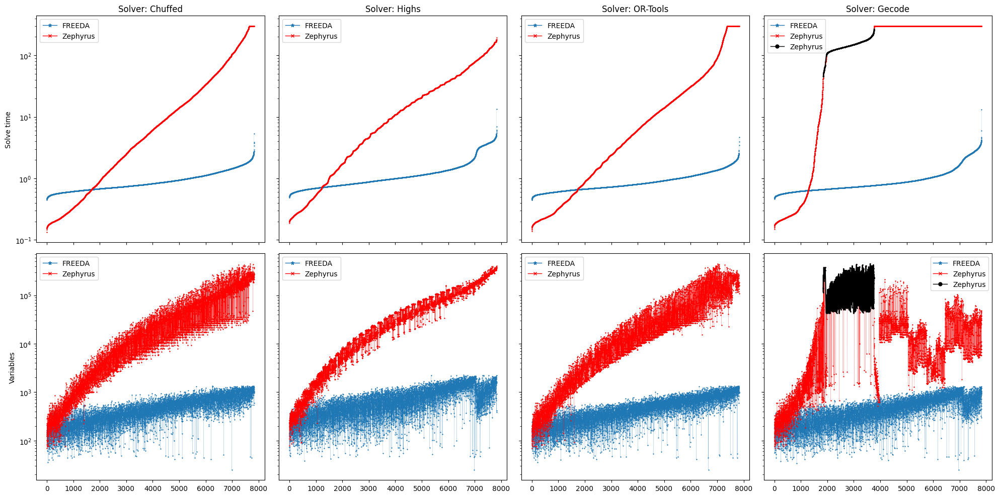

In [50]:
fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    sharex=True,
    sharey="row",
    figsize=(5 * len(solvers), 10),
)

for solver, ax in zip(solvers, axs.T):
    for model in models:
        d = (
            df
            .query("solver == @solver")
            .query("model == @model")
            .sort_values("solve_time", ascending=True)
            .reset_index(drop=True)
            .reset_index()
        )
        ax[0].plot(
            d.index,
            d.solve_time,
            marker=marker_model[model],
            c=color_model[model],
            label=model,
            markersize=1,
            linewidth=0.1
        )
        ax[1].plot(
            d.index,
            d.flatzinc_vars,
            marker=marker_model[model],
            c=color_model[model],
            label=model,
            markersize=1,
            linewidth=0.1
        )
        err = d.query("status == 'Error'")
        if len(err) > 0:
            for i, what in zip([0, 1], ["solve_time", "flatzinc_vars"]):
                ax[i].plot(
                    err.index,
                    err[what],
                    marker="o",
                    c="black",
                    label=model,
                    markersize=1,
                )
        ax[0].set_title("Solver: " + solver)
        ax[0].set_yscale('log')
        ax[1].set_yscale('log')
        ax[0].set_xlabel("")
        ax[1].set_xlabel("")
        ax[0].legend(fontsize=10, markerscale=5)
        ax[1].legend(fontsize=10, markerscale=5)
        for i in [0, 1]:
            for legend_line in ax[i].get_legend().get_lines():
                legend_line.set_linewidth(1)

axs[0][0].set_ylabel("Solve time")
axs[1][0].set_ylabel("Variables")
fig.tight_layout()

In [51]:
save_fig(fig, "solve-time-log-zeph")

In [52]:
mean_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg all"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_solve_time

avg all
model    solver           
FREEDA   Chuffed     0.94s
         Gecode       1.0s
         Highs       1.28s
         OR-Tools    0.91s
Zephyrus Chuffed    33.86s
         Gecode    191.77s
         Highs      26.36s
         OR-Tools   36.88s

In [53]:
mean_opt_solve_time = (
    df
    .query("status == 'Optimal solution' or status == 'Unsatisfiable'")
    [["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg solved"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_opt_solve_time

avg solved
model    solver             
FREEDA   Chuffed       0.94s
         Gecode         1.0s
         Highs         1.28s
         OR-Tools      0.91s
Zephyrus Chuffed      27.52s
         Gecode        8.66s
         Highs        26.36s
         OR-Tools     20.05s

In [54]:
perc = (
    df[["model", "solver", "status"]]
    .groupby(["model", "solver"])
    .aggregate(lambda x : str(round((
        len(x[x.str.contains("Optimal solution") | x.str.contains("Unsatisfiable")]) / len(x)) * 100,
        2)) + "%")
    .rename(columns={"status" : "solved"})
)
perc

solved
model    solver          
FREEDA   Chuffed   100.0%
         Gecode    100.0%
         Highs     100.0%
         OR-Tools  100.0%
Zephyrus Chuffed   97.68%
         Gecode    25.03%
         Highs     100.0%
         OR-Tools  93.96%

In [55]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"]).query("components != 32 and nodes != 4 and comps_topology != 'small-world'")

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

scores = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        scores.append(group.assign(score=borda_count))

In [56]:
scores_df = (
    pd.concat(scores)
    [["model", "solver", "score"]]
    .groupby(["model", "solver"])
    .sum()
    .map(lambda x : round(x, 2))
)
scores_df

score
model    solver            
FREEDA   Chuffed   24779.68
         Gecode    25037.10
         Highs     21829.33
         OR-Tools  25026.20
Zephyrus Chuffed   12863.04
         Gecode     3301.45
         Highs     10805.66
         OR-Tools  12773.55

In [57]:
min_max = (
    df[["model", "solve_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate(["min", "max"])
    .map(lambda x : str(round(x, 2)) + "s")
)
min_max.columns = min_max.columns.droplevel()
min_max

min      max
model    solver                  
FREEDA   Chuffed   0.44s    5.29s
         Gecode    0.46s   13.17s
         Highs     0.49s   13.35s
         OR-Tools  0.45s    4.69s
Zephyrus Chuffed   0.13s   300.0s
         Gecode    0.15s   300.0s
         Highs     0.19s  193.63s
         OR-Tools  0.14s   300.0s

In [58]:
flat = (
    df[["model", "flat_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"flat_time" : "flat"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
flat

flat
model    solver          
FREEDA   Chuffed    0.81s
         Gecode     0.81s
         Highs      1.15s
         OR-Tools   0.79s
Zephyrus Chuffed    8.98s
         Gecode     9.06s
         Highs     24.42s
         OR-Tools   8.92s

In [59]:
first_last = (
    df
    .query("status == 'Optimal solution' or status == 'Satisfiable'")
    [["model", "objectives", "solver"]]
    .assign(**{
        "first" : lambda df : df.objectives.apply(lambda d : min(float(t) for t in d.keys())),
        "last" : lambda df : df.objectives.apply(lambda d : max(float(t) for t in d.keys()))
    }).drop(columns=["objectives"])
    .groupby(["model", "solver"])
    .aggregate("mean")
    .map(lambda x : str(round(x, 2)) + "s")
)
first_last

first    last
model    solver                  
FREEDA   Chuffed    0.85s   0.94s
         Gecode     0.98s    1.0s
         Highs      1.26s   1.26s
         OR-Tools   0.87s    0.9s
Zephyrus Chuffed   19.24s  27.59s
         Gecode     6.59s  11.37s
         Highs     26.05s  26.24s
         OR-Tools  18.51s  20.43s

In [60]:
table = pd.concat([
    perc,
    mean_solve_time,
    mean_opt_solve_time,
    min_max,
    first_last,
    flat,
    scores_df,
], axis=1).sort_values("score", ascending=False)
table

solved  avg all avg solved    min      max   first    last  \
model    solver                                                                 
FREEDA   Gecode    100.0%     1.0s       1.0s  0.46s   13.17s   0.98s    1.0s   
         OR-Tools  100.0%    0.91s      0.91s  0.45s    4.69s   0.87s    0.9s   
         Chuffed   100.0%    0.94s      0.94s  0.44s    5.29s   0.85s   0.94s   
         Highs     100.0%    1.28s      1.28s  0.49s   13.35s   1.26s   1.26s   
Zephyrus Chuffed   97.68%   33.86s     27.52s  0.13s   300.0s  19.24s  27.59s   
         OR-Tools  93.96%   36.88s     20.05s  0.14s   300.0s  18.51s  20.43s   
         Highs     100.0%   26.36s     26.36s  0.19s  193.63s  26.05s  26.24s   
         Gecode    25.03%  191.77s      8.66s  0.15s   300.0s   6.59s  11.37s   

                     flat     score  
model    solver                      
FREEDA   Gecode     0.81s  25037.10  
         OR-Tools   0.79s  25026.20  
         Chuffed    0.81s  24779.68  
         Highs      1.15s  21829.33  
Zephyrus Chuffed    8.98s  12863.04  
         OR-Tools   8.92s  12773.55  
         Highs     24.42s  10805.66  
         Gecode     9.06s   3301.45

In [61]:
print(
    table.to_latex(multicolumn=False, escape=True, multirow=False, float_format="%.2f")
)

\begin{tabular}{llllllllllr}
\toprule
 &  & solved & avg all & avg solved & min & max & first & last & flat & score \\
model & solver &  &  &  &  &  &  &  &  &  \\
\midrule
FREEDA & Gecode & 100.0\% & 1.0s & 1.0s & 0.46s & 13.17s & 0.98s & 1.0s & 0.81s & 25037.10 \\
 & OR-Tools & 100.0\% & 0.91s & 0.91s & 0.45s & 4.69s & 0.87s & 0.9s & 0.79s & 25026.20 \\
 & Chuffed & 100.0\% & 0.94s & 0.94s & 0.44s & 5.29s & 0.85s & 0.94s & 0.81s & 24779.68 \\
 & Highs & 100.0\% & 1.28s & 1.28s & 0.49s & 13.35s & 1.26s & 1.26s & 1.15s & 21829.33 \\
Zephyrus & Chuffed & 97.68\% & 33.86s & 27.52s & 0.13s & 300.0s & 19.24s & 27.59s & 8.98s & 12863.04 \\
 & OR-Tools & 93.96\% & 36.88s & 20.05s & 0.14s & 300.0s & 18.51s & 20.43s & 8.92s & 12773.55 \\
 & Highs & 100.0\% & 26.36s & 26.36s & 0.19s & 193.63s & 26.05s & 26.24s & 24.42s & 10805.66 \\
 & Gecode & 25.03\% & 191.77s & 8.66s & 0.15s & 300.0s & 6.59s & 11.37s & 9.06s & 3301.45 \\
\bottomrule
\end{tabular}



In [62]:
freeda_slower = []
for _, g in df.groupby(["components", "nodes", "comps_topology", "test", "solver"]):
    freeda = g.query("model == 'FREEDA'")
    zephyrus = g.query("model == 'Zephyrus'")

    if len(freeda) != 1:
        print("MORE THAN ONE FREEDA")
        print(g)
    if len(zephyrus) != 1:
        print("MORE THAN ONE ZEPHYRUS")

    if freeda.solve_time.iloc[0] > zephyrus.solve_time.iloc[0]:
        freeda_slower.append(freeda)

In [63]:
freeda_slower_table = (
    pd.concat(freeda_slower)
    .groupby("solver")
    ["status"]
    .aggregate(**{"status" : "count"})
    .rename(columns={"status" : "amount"})
    .assign(**{"%" : lambda df : df.apply(lambda x : x.amount / (len(combinations) / len(solvers)) * 100 , axis=1)})
)
freeda_slower_table.loc["TOTAL", "%"] = freeda_slower_table.amount.sum() / len(combinations) * 100
freeda_slower_table.loc["TOTAL", "amount"] = freeda_slower_table.amount.sum()
freeda_slower_table

,amount,%
solver,,
Chuffed,1693.0,10.810983
Gecode,1289.0,8.231162
Highs,1289.0,8.231162
OR-Tools,1729.0,11.040868
TOTAL,6000.0,9.578544
